## Ciclo Stirling.

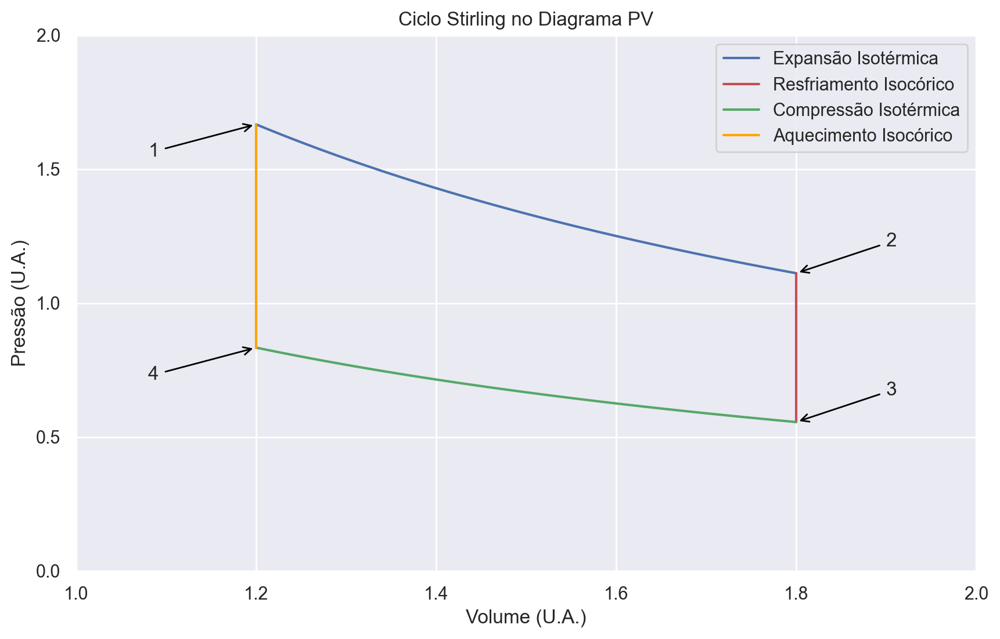

In [1]:
import warnings
warnings.simplefilter(action = 'ignore', category = FutureWarning)
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
import matplotlib.ticker as mticker
sns.set(style = 'darkgrid')


# Vamos escolher dois valores diferentes de volume de gás para calcular as trajetórias dos processos.
# O ponto 1 = (P1, V1) define o início do ciclo. Os valores e as unidades adotados são arbitrários e
# faremos nR = 1, por simplicidade.
V1 = V4 = 1.2
V2 = V3 = 1.8 

# Ponto 1: Início do primeiro processo - expansão isotérmica do gás. Vamos usar a equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. Logo: PV = T.
T1 = 2.0  # Temperatura no Ponto 1 do Diagrama PV.
P1 = T1 / V1  # Pressão no Ponto 1 do Diagrama PV.
# Ponto 2: Final do primeiro processo - expansão isotérmica do gás.
# Temperatura no Ponto 2 do Diagrama PV é a mesma que a do Ponto 1. Essa temperatura deve 
# ser a mesma que aquela do Ponto 1, pois ocorreu uma expansão isotérmica.
T2 = T1      
# Gerando os pontos para a curva que representa a expansão isotérmica do gás.
V_exp_isobarica = np.linspace(V1, V2, 100)
P_exp_isobarica = T1 / V_exp_isobarica

# Ponto 2: Início do segundo processo: resfriamento isocórico (volume constante) do gás. 
# No Ponto 2 do ciclo, o volume do gás é V2. A pressão no Ponto 2 é dada pela equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. 
P2 = T2 / V2 
# No ponto 3 do ciclo, a temperatura será T3, menor que T1 (ou T2):
T3 = 1.0
# Para um processo isocórico ou isovolumétrico (com volume constante), P3*T2 = P2*T3.
P3 = P2 * T3 / T2
# Gerando os pontos para a curva que representa a desaquecimento isocórico do gás.
P_descomp_isocorica = np.linspace(P2, P3, 100)
V_descomp_isocorica = np.linspace(V2, V3, 100)

# Ponto 3: Início do terceiro Processo - compressão isotérmica do gás. Usamos a equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. 
# Gerando os pontos para a curva que representa a compressão isotérmica do gás.
V_comp_isobarica = np.linspace(V3, V4, 100)
P_comp_isobarica = T3 / V_comp_isobarica

# Ponto 4: Início do quarto processo: aquecimento isocórico (volume constante) do gás. 
# Temperatura no Ponto 4 do Diagrama PV é a mesma que a do Ponto 3. Essa temperatura deve 
# ser a mesma que aquela do Ponto 3, pois ocorreu uma compressão isotérmica.
T4 = T3
# No Ponto 4 do ciclo, o volume do gás é V4. A pressão no Ponto 4 é dada pela equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. 
P4 = T4 / V4 
# Gerando os pontos para a curva que representa o aquecimento isocórico do gás.
P_comp_isocorica = np.linspace(P4, P1, 100)
V_comp_isocorica = np.linspace(V4, V1, 100)

# Plotagem do diagrama PV.
plt.subplots(1, 1, figsize = (10, 6), dpi = 200)
plt.plot(V_exp_isobarica, P_exp_isobarica, 'b', label = 'Expansão Isotérmica')
plt.plot(V_descomp_isocorica, P_descomp_isocorica, 'r', label = 'Resfriamento Isocórico')
plt.plot(V_comp_isobarica, P_comp_isobarica, 'g', label = 'Compressão Isotérmica')
plt.plot(V_comp_isocorica, P_comp_isocorica, 'orange', label = 'Aquecimento Isocórico')
plt.xlabel('Volume (U.A.)')
plt.ylabel('Pressão (U.A.)')
plt.xlim((1.0, 2.0))
plt.ylim((0, 2.0))
plt.title('Ciclo Stirling no Diagrama PV')
plt.legend()
plt.grid(True)
# Setas indicando os inícios dos processos do ciclo.
plt.annotate('1', (V1, P1), (V1 - 0.12, P1 - 0.12), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('2', (V2, P2), (V2 + 0.1, P2 + 0.1), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('3', (V3, P3), (V3 + 0.1, P3 + 0.1), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('4', (V4, P4), (V4 - 0.12, P4 - 0.12), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.gca().yaxis.set_major_locator(mticker.MultipleLocator(0.5))
plt.show()

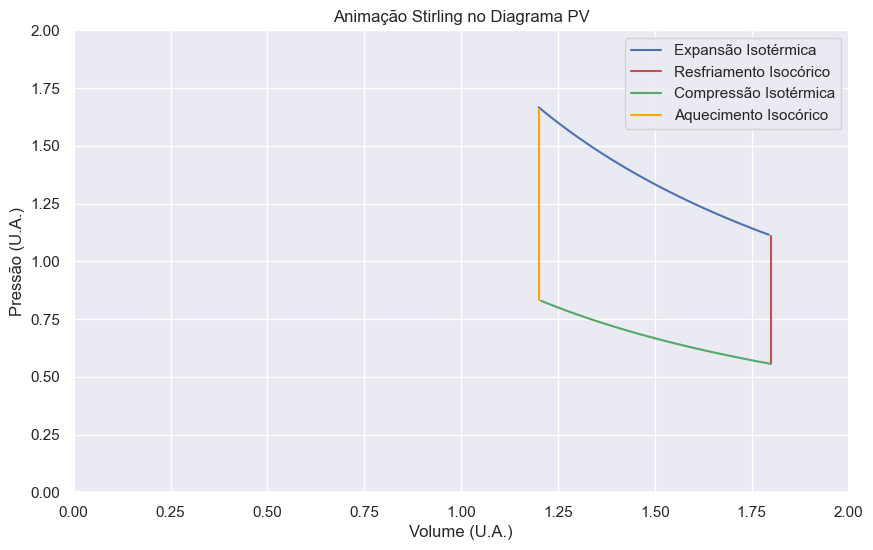

In [2]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

plt.rcParams['animation.embed_limit'] = 256
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 2)
ax.set_xlim(0, 2) 
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação Stirling no Diagrama PV')

V_A = V_exp_isobarica
P_A = P_exp_isobarica
V_B = V_descomp_isocorica
P_B = P_descomp_isocorica
V_C = V_comp_isobarica
P_C = P_comp_isobarica
V_D = V_comp_isocorica
P_D = P_comp_isocorica


# Inicializando as curvas como linhas vazias
line_A, = ax.plot([], [], 'b', label = 'Expansão Isotérmica')
line_B, = ax.plot([], [], 'r', label = 'Resfriamento Isocórico')
line_C, = ax.plot([], [], 'g', label = 'Compressão Isotérmica')
line_D, = ax.plot([], [], 'orange', label = 'Aquecimento Isocórico')


# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
    line_A.set_data([], [])
    line_B.set_data([], [])
    line_C.set_data([], [])
    line_D.set_data([], [])
    return line_A, line_B, line_C, line_D

# Função de animação
def animate(frame):
    # Atualizando os dados das curvas
    if frame < len(V_A):
        line_A.set_data(V_A[:frame], P_A[:frame])
    elif frame < len(V_A) + len(V_B):
        line_B.set_data(V_B[:frame-len(V_A)], P_B[:frame-len(V_A)])
    elif frame < len(V_A) + len(V_B) + len(V_C):
        line_C.set_data(V_C[:frame-(len(V_A)+len(V_B))], P_C[:frame-(len(V_A)+len(V_B))])
    else:
        line_D.set_data(V_D[:frame-(len(V_A)+len(V_B)+len(V_C))], P_D[:frame-(len(V_A)+len(V_B)+len(V_C))])

    return line_A, line_B, line_C, line_D

# Configurando a animação
total_frames = len(V_A) + len(V_B) + len(V_C) + len(V_D)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())
